# ART - PGD Attack on YOLOv8 (Tank Dataset)

이 노트북은 커스텀 Tank 데이터셋에 대해 YOLOv8 모델을 사용한 PGD (Projected Gradient Descent) 공격을 시연합니다.

**공격 방법**: Projected Gradient Descent (PGD)  
**모델**: YOLOv8n with PyTorchYoloLossWrapper  
**데이터셋**: Custom Tank Detection Dataset

**PGD vs Patch Attack:**
- **PGD**: 전체 이미지에 대한 미세한 픽셀 단위 섭동 (물리적 구현 어려움)
- **Patch**: 국소적인 패치 추가 (물리적 구현 가능)

PGD는 디지털 공격으로, 모델의 취약점을 분석하고 방어 기법을 평가하는 데 유용합니다.

## 1. 환경 설정 및 임포트

In [1]:
import os
import sys
import numpy as np
import torch
import cv2
import yaml
from pathlib import Path
from PIL import Image
from tqdm import tqdm
import matplotlib.pyplot as plt
import matplotlib
from pathlib import Path
# Ultralytics YOLO
from ultralytics import YOLO

# ART imports
from art.estimators.object_detection import PyTorchYolo
from art.attacks.evasion import ProjectedGradientDescent

# Matplotlib 설정
plt.style.use('ggplot')
%matplotlib inline

# CUDA 정보
print(f"PyTorch version: {torch.__version__}")
print(f"CUDA available: {torch.cuda.is_available()}")
if torch.cuda.is_available():
    print(f"CUDA device: {torch.cuda.get_device_name(0)}")

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

PyTorch version: 2.8.0+cu128
CUDA available: True
CUDA device: NVIDIA GeForce RTX 5080
Using device: cuda


## 2. 데이터셋 설정

In [2]:
# 경로 설정 - 노트북이 실행되는 위치 기준 상대 경로
import os
from pathlib import Path

# Get the directory where this notebook is located
NOTEBOOK_DIR = Path(os.getcwd())

# All paths relative to notebook directory
# Assuming notebook is in: art_training/attacks/
# Project root is: ../../ from notebook
PROJECT_ROOT = NOTEBOOK_DIR / ".." / ".."

# Model and data paths relative to project root  
DATA_YAML = PROJECT_ROOT / "dataset_only_tank" / "data.yaml"
MODEL_PATH = PROJECT_ROOT / "runs" / "detect" / "train_only_tank" / "weights" / "best.pt"

# Resolve to absolute paths for verification
DATA_YAML = DATA_YAML.resolve()
MODEL_PATH = MODEL_PATH.resolve()

print(f"Notebook directory: {NOTEBOOK_DIR.resolve()}")
print(f"Project root: {PROJECT_ROOT.resolve()}")
print(f"Data YAML: {DATA_YAML}")
print(f"Model path: {MODEL_PATH}")

# data.yaml 로드
with open(DATA_YAML, 'r') as f:
    data_config = yaml.safe_load(f)

print("\nDataset configuration:")
print(f"  Number of classes: {data_config['nc']}")
print(f"  Class names: {data_config['names']}")
print(f"  Training images: {data_config['train']}")
print(f"  Validation images: {data_config['val']}")

# 클래스 이름
CLASS_NAMES = data_config['names']

Notebook directory: /home/jaehyun/art_train/yolo_train/art_training/attacks
Project root: /home/jaehyun/art_train/yolo_train
Data YAML: /home/jaehyun/art_train/yolo_train/dataset_only_tank/data.yaml
Model path: /home/jaehyun/art_train/yolo_train/runs/detect/train_only_tank/weights/best.pt

Dataset configuration:
  Number of classes: 1
  Class names: {0: 'Tank'}
  Training images: train/images
  Validation images: valid/images


## 3. 유틸리티 함수

In [3]:
def extract_predictions(predictions, conf_thresh=0.5):
    """예측 결과에서 신뢰도 임계값 이상의 탐지만 추출"""
    if not isinstance(predictions, dict):
        return [], [], []
    
    # 신뢰도 점수로 먼저 필터링
    predictions_score = list(predictions["scores"])
    predictions_t = [i for i, x in enumerate(predictions_score) if x > conf_thresh]
    
    if len(predictions_t) == 0:
        return [], [], []
    
    # 필터링된 예측 결과
    predictions_boxes = [[(predictions["boxes"][i][0], predictions["boxes"][i][1]), 
                          (predictions["boxes"][i][2], predictions["boxes"][i][3])] 
                         for i in predictions_t]
    predictions_scores = [predictions_score[i] for i in predictions_t]
    
    # 클래스 이름 가져오기 (안전하게 처리)
    predictions_class = []
    for i in predictions_t:
        label_idx = int(predictions["labels"][i])
        # 인덱스가 범위를 벗어나면 기본 클래스명 사용
        if 0 <= label_idx < len(CLASS_NAMES):
            predictions_class.append(CLASS_NAMES[label_idx])
        else:
            predictions_class.append(CLASS_NAMES[0])
    
    return predictions_class, predictions_boxes, predictions_scores


def plot_image_with_boxes(img, boxes, pred_cls, pred_scores=None, title="Detection"):
    """이미지에 바운딩 박스와 클래스 레이블을 그립니다."""
    text_size = 0.8
    text_th = 2
    rect_th = 2
    
    # 이미지 복사
    img_display = img.copy()
    
    for i in range(len(boxes)):
        # 바운딩 박스 그리기
        cv2.rectangle(
            img_display, 
            (int(boxes[i][0][0]), int(boxes[i][0][1])), 
            (int(boxes[i][1][0]), int(boxes[i][1][1])),
            color=(0, 255, 0), 
            thickness=rect_th
        )
        
        # 클래스 레이블 및 신뢰도 텍스트
        if pred_scores:
            label = f"{pred_cls[i]}: {pred_scores[i]:.2f}"
        else:
            label = pred_cls[i]
        
        cv2.putText(
            img_display, 
            label, 
            (int(boxes[i][0][0]), int(boxes[i][0][1]) - 5), 
            cv2.FONT_HERSHEY_SIMPLEX, 
            text_size,
            (0, 255, 0), 
            thickness=text_th
        )
    
    plt.figure(figsize=(10, 10))
    plt.axis("off")
    plt.title(title, fontsize=14, weight='bold')
    plt.imshow(img_display.astype(np.uint8), interpolation="nearest")
    plt.show()


def filter_boxes(predictions, conf_thresh=0.5):
    """신뢰도 임계값으로 예측 필터링 (ART 형식)"""
    dictionary = {}
    
    boxes_list = []
    scores_list = []
    labels_list = []
    
    for i in range(len(predictions["boxes"])):
        score = predictions["scores"][i]
        if score >= conf_thresh:
            boxes_list.append(predictions["boxes"][i])
            scores_list.append(predictions["scores"][i])
            labels_list.append(predictions["labels"][i])
    
    if len(boxes_list) == 0:
        dictionary["boxes"] = np.array([], dtype=np.float32).reshape(0, 4)
        dictionary["scores"] = np.array([], dtype=np.float32)
        dictionary["labels"] = np.array([], dtype=np.int64)
    else:
        dictionary["boxes"] = np.vstack(boxes_list)
        dictionary["scores"] = np.hstack(scores_list)
        dictionary["labels"] = np.hstack(labels_list)
    
    return dictionary


def compute_perturbation_metrics(original, adversarial):
    """섭동 메트릭 계산"""
    perturbation = adversarial - original
    
    # L-inf norm (최대 픽셀 변화)
    linf_norm = np.max(np.abs(perturbation))
    
    # L2 norm (평균 제곱근 오차)
    l2_norm = np.sqrt(np.mean(perturbation ** 2))
    
    # 평균 절대 오차
    mae = np.mean(np.abs(perturbation))
    
    return {
        'linf_norm': linf_norm,
        'l2_norm': l2_norm,
        'mae': mae
    }

## 4. 데이터 로드

In [4]:
def load_images_from_directory(image_dir, num_images=10, img_size=640):
    """디렉토리에서 이미지 로드"""
    image_dir = Path(image_dir).resolve()
    
    # 이미지 파일 검색
    image_files = []
    for ext in ['*.jpg', '*.jpeg', '*.JPG', '*.JPEG', '*.png', '*.PNG']:
        image_files.extend(list(image_dir.glob(ext)))
    
    if len(image_files) == 0:
        print(f"Warning: No images found in {image_dir}")
        return np.array([]), []
    
    image_files = sorted(image_files)[:num_images]
    
    images = []
    for img_path in tqdm(image_files, desc="Loading images"):
        # PIL로 이미지 로드
        img = Image.open(img_path).convert('RGB')
        # 리사이즈 (640x640)
        img = img.resize((img_size, img_size), Image.BICUBIC)
        # numpy 배열로 변환 (H, W, C)
        img_array = np.array(img)
        # (C, H, W) 형식으로 변환
        img_array = img_array.transpose(2, 0, 1)
        images.append(img_array)
    
    # [0, 255] 범위로 유지 (YOLOv8은 0-255 사용)
    return np.array(images, dtype=np.float32), [str(p) for p in image_files]


# 검증 데이터 로드
data_yaml_dir = Path(DATA_YAML).parent.resolve()

# test 디렉토리에서 이미지 로드
test_paths = [
    data_yaml_dir / "test" / "images",
]

for path in test_paths:
    print(f"Trying: {path}")
    if path.exists():
        tank_images, image_paths = load_images_from_directory(path)
        if len(tank_images) > 0:
            print(f"\n✓ Loaded {len(tank_images)} images from {path}")
            break

if tank_images is None or len(tank_images) == 0:
    raise ValueError("No images found! Please check the data paths.")


print(f"\nImage shape: {tank_images.shape}")
print(f"Value range: [{tank_images.min():.1f}, {tank_images.max():.1f}]")

Trying: /home/jaehyun/art_train/yolo_train/dataset_only_tank/test/images


Loading images: 100%|██████████| 10/10 [00:00<00:00, 485.26it/s]


✓ Loaded 10 images from /home/jaehyun/art_train/yolo_train/dataset_only_tank/test/images

Image shape: (10, 3, 640, 640)
Value range: [0.0, 255.0]


## 5. YOLOv8 모델 설정

In [5]:
# YOLOv8 모델 로드
print(f"Loading YOLOv8 model from {MODEL_PATH}")
yolo_base = YOLO(MODEL_PATH)
model = yolo_base.model

# 모델을 디바이스로 이동 (PyTorchYolo가 자동으로 래핑함)
model.to(device)
model.train()  # 학습 모드 (gradient 계산 필요)

print(f"Model loaded and moved to {device}")
print(f"Model in training mode: {model.training}")

Loading YOLOv8 model from /home/jaehyun/art_train/yolo_train/runs/detect/train_only_tank/weights/best.pt
Model loaded and moved to cuda
Model in training mode: True


In [6]:
# ART PyTorchYolo Estimator 생성
INPUT_SHAPE = (3, 640, 640)

detector = PyTorchYolo(
    model=model,
    device_type='cuda' if torch.cuda.is_available() else 'cpu',
    input_shape=INPUT_SHAPE,
    clip_values=(0, 255),  # YOLOv8은 [0, 255] 범위 사용
    channels_first=True,
    attack_losses=("loss_total", "loss_cls", "loss_box", "loss_dfl"),
    is_ultralytics=True,
    model_name="yolov8n"
)

print("ART PyTorchYolo Estimator created successfully!")
print(f"  Input shape: {detector.input_shape}")
print(f"  Clip values: {detector.clip_values}")
print(f"  Attack losses: {detector.attack_losses}")

ART PyTorchYolo Estimator created successfully!
  Input shape: (3, 640, 640)
  Clip values: [          0         255]
  Attack losses: ('loss_total', 'loss_cls', 'loss_box', 'loss_dfl')


## 6. 원본 이미지에 대한 탐지 결과

In [7]:
# 원본 이미지 예측
print("Running predictions on original images...")
dets_original = detector.predict(tank_images)

print(f"\nPredictions for {len(dets_original)} images:")
for i, det in enumerate(dets_original):
    num_detections = len(det['boxes'])
    print(f"  Image {i+1}: {num_detections} detections")

Running predictions on original images...

Predictions for 10 images:
  Image 1: 0 detections
  Image 2: 0 detections
  Image 3: 0 detections
  Image 4: 0 detections
  Image 5: 0 detections
  Image 6: 0 detections
  Image 7: 0 detections
  Image 8: 0 detections
  Image 9: 0 detections
  Image 10: 0 detections


Visualizing original detections...


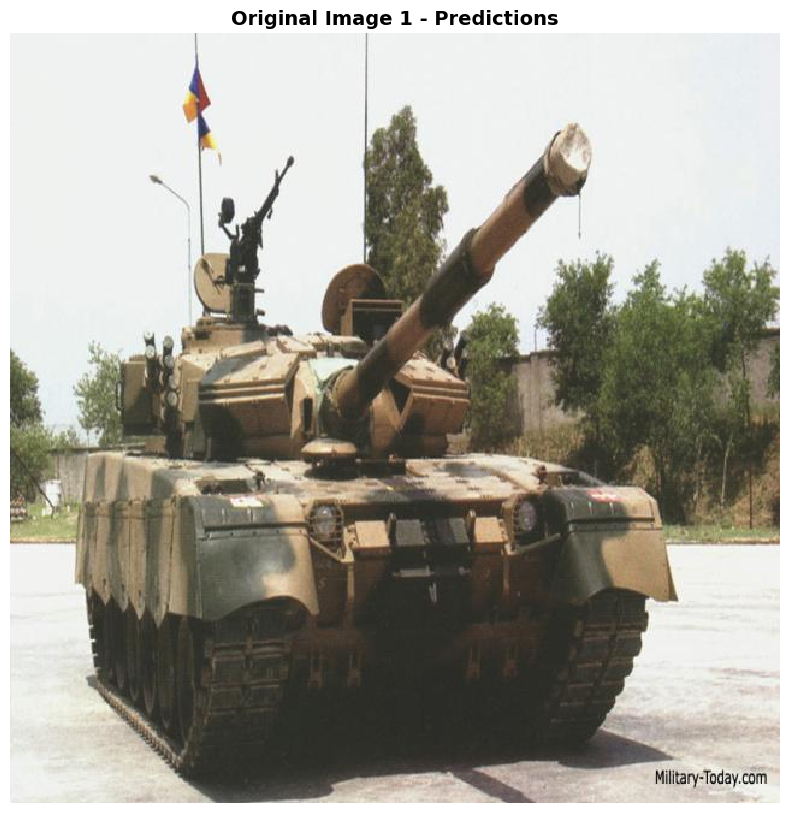

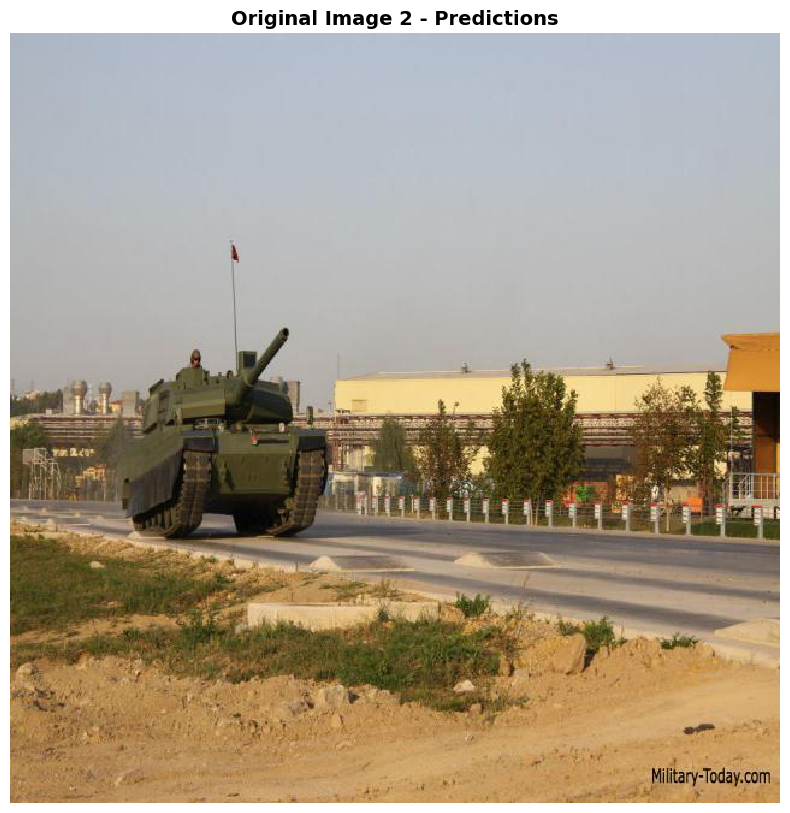

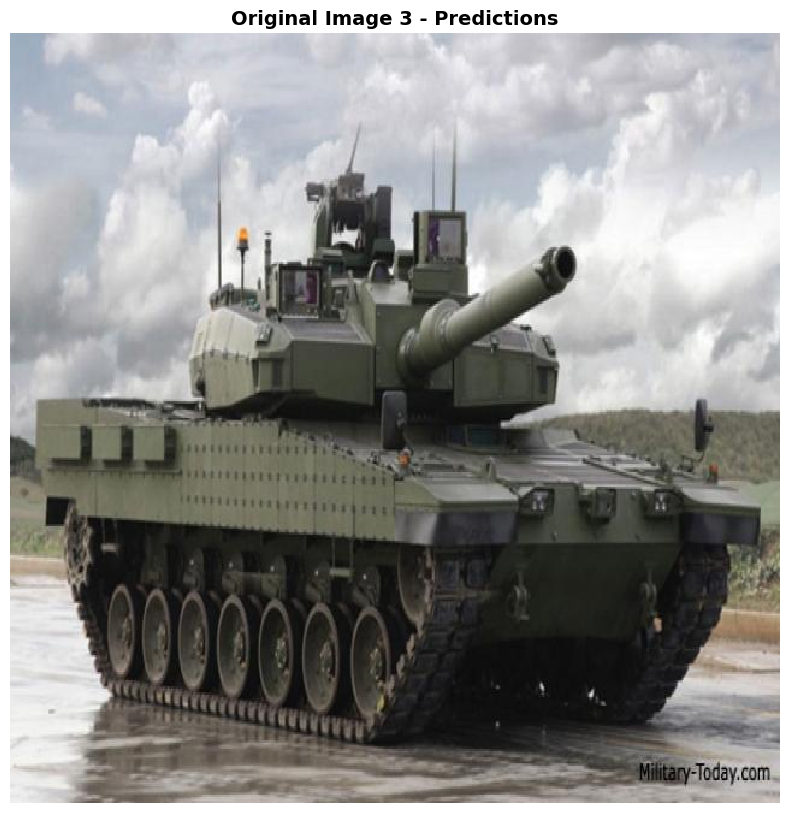

In [ ]:
# 원본 이미지 탐지 결과 시각화
print("Visualizing original detections...")

for i in range(0, len(dets_original)):
    preds_orig = extract_predictions(dets_original[i], conf_thresh=0.5)
    img_display = tank_images[i].transpose(1, 2, 0).copy()
    plot_image_with_boxes(
        img=img_display, 
        boxes=preds_orig[1], 
        pred_cls=preds_orig[0],
        pred_scores=preds_orig[2],
        title=f"Original Image {i+1} - Predictions"
    )

## 7. PGD 공격 설정

**PGD (Projected Gradient Descent) 파라미터:**
- `norm`: 섭동 제약 노름 (np.inf, 1, 2)
- `eps`: 최대 섭동 크기 (L-inf norm의 경우 최대 픽셀 변화량)
- `eps_step`: 각 반복의 스텝 크기
- `max_iter`: 최대 반복 횟수
- `targeted`: False = 탐지 회피, True = 특정 클래스로 오분류
- `num_random_init`: 랜덤 초기화 횟수 (0 = FGSM, >0 = PGD)

In [ ]:
# PGD 공격 파라미터
# L-inf norm: 각 픽셀의 최대 변화량을 제한
eps = 8.0          # 최대 섭동 크기 (0-255 범위에서 ±8 픽셀)
eps_step = 2.0     # 각 반복의 스텝 크기
max_iter = 10      # PGD 반복 횟수
batch_size = 1     # 배치 크기




print("PGD Attack Parameters:")
print(f"  Norm: L-inf")
print(f"  Epsilon (max perturbation): {eps}")
print(f"  Epsilon step: {eps_step}")
print(f"  Max iterations: {max_iter}")
print(f"  Batch size: {batch_size}")

PGD Attack Parameters:
  Norm: L-inf
  Epsilon (max perturbation): 8.0
  Epsilon step: 2.0
  Max iterations: 100
  Batch size: 1


## 8. 타겟 레이블 준비

**Untargeted Attack**: 탱크 탐지를 회피하기 위해 원본 탐지 결과를 타겟으로 사용

In [10]:
# 타겟 레이블 필터링 (신뢰도 임계값 적용)
y_target = [filter_boxes(det, conf_thresh=0.5) for det in dets_original]

print(f"Target labels prepared for {len(y_target)} images")
for i, y in enumerate(y_target[:3]):
    print(f"  Image {i+1}: {len(y['boxes'])} target boxes")

Target labels prepared for 10 images
  Image 1: 0 target boxes
  Image 2: 0 target boxes
  Image 3: 0 target boxes


## 9. PGD 공격 생성

In [11]:
# ProjectedGradientDescent 공격 객체 생성
pgd_attack = ProjectedGradientDescent(
    estimator=detector,
    norm=np.inf,  # L-inf norm
    eps=eps,
    eps_step=eps_step,
    max_iter=max_iter,
    targeted=False,  # Untargeted: 탐지 회피
    batch_size=batch_size,
    verbose=True
)

print("ProjectedGradientDescent attack created!")

ProjectedGradientDescent attack created!


In [12]:
# PGD 적대적 예제 생성
print(f"\nGenerating adversarial examples with PGD...")
print(f"This may take a few minutes...\n")

# PGD 공격 실행
adversarial_images = pgd_attack.generate(x=tank_images, y=y_target)

print(f"\n✓ Adversarial examples generated!")
print(f"Adversarial images shape: {adversarial_images.shape}")
print(f"Value range: [{adversarial_images.min():.1f}, {adversarial_images.max():.1f}]")


Generating adversarial examples with PGD...
This may take a few minutes...



PGD - Iterations:   0%|          | 0/100 [00:00<?, ?it/s]


✓ Adversarial examples generated!
Adversarial images shape: (10, 3, 640, 640)
Value range: [0.0, 255.0]


## 10. 섭동 분석

In [13]:
# 섭동 메트릭 계산
print("Computing perturbation metrics...\n")

for i in range(min(3, len(tank_images))):
    metrics = compute_perturbation_metrics(tank_images[i], adversarial_images[i])
    print(f"Image {i+1}:")
    print(f"  L-inf norm: {metrics['linf_norm']:.4f}")
    print(f"  L2 norm: {metrics['l2_norm']:.4f}")
    print(f"  MAE: {metrics['mae']:.4f}")

Computing perturbation metrics...

Image 1:
  L-inf norm: 8.0000
  L2 norm: 5.3433
  MAE: 4.6638
Image 2:
  L-inf norm: 8.0000
  L2 norm: 5.3918
  MAE: 4.7224
Image 3:
  L-inf norm: 8.0000
  L2 norm: 5.2855
  MAE: 4.5961



Visualizing perturbations...


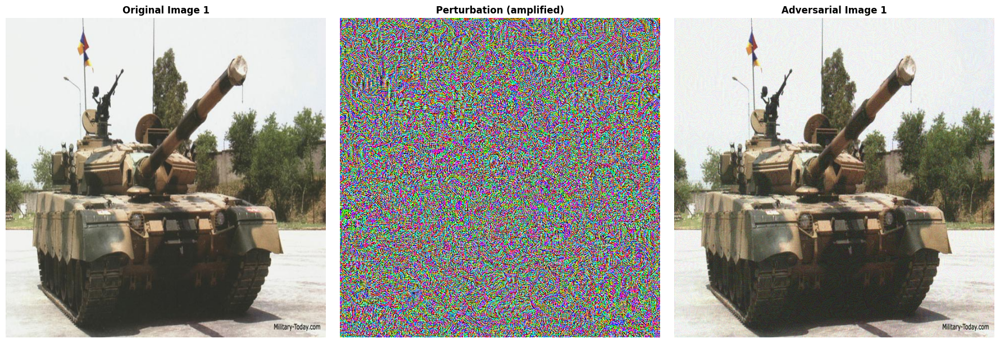

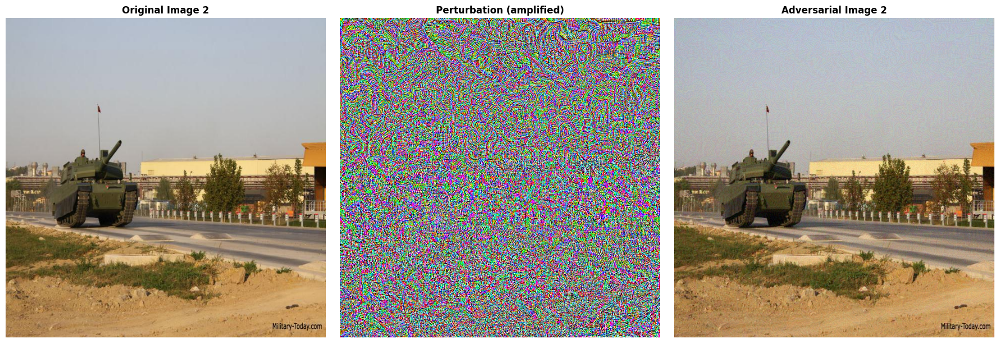

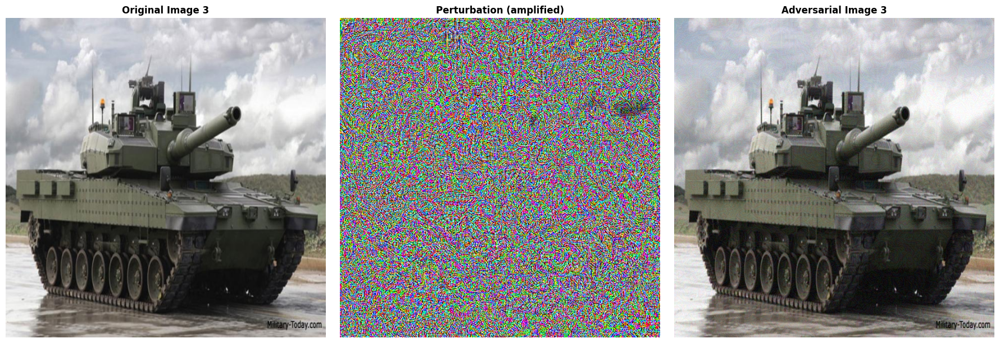

In [ ]:
# 섭동 시각화
print("\nVisualizing perturbations...")

for i in range(0, len(tank_images)):
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))
    
    # 원본 이미지
    img_orig = tank_images[i].transpose(1, 2, 0).astype(np.uint8)
    axes[0].imshow(img_orig)
    axes[0].set_title(f"Original Image {i+1}", fontsize=12, weight='bold')
    axes[0].axis('off')
    
    # 섭동 (증폭해서 표시)
    perturbation = adversarial_images[i] - tank_images[i]
    perturbation_vis = perturbation.transpose(1, 2, 0)
    # 섭동을 [-eps, eps] 범위에서 [0, 255] 범위로 스케일링
    perturbation_vis = ((perturbation_vis + eps) / (2 * eps) * 255).clip(0, 255).astype(np.uint8)
    axes[1].imshow(perturbation_vis)
    axes[1].set_title(f"Perturbation (amplified)", fontsize=12, weight='bold')
    axes[1].axis('off')
    
    # 적대적 이미지
    img_adv = adversarial_images[i].transpose(1, 2, 0).astype(np.uint8)
    axes[2].imshow(img_adv)
    axes[2].set_title(f"Adversarial Image {i+1}", fontsize=12, weight='bold')
    axes[2].axis('off')
    
    plt.tight_layout()
    plt.show()

## 11. 적대적 예제 평가

In [15]:
# 적대적 예제에 대한 탐지
print("Running predictions on adversarial images...")
dets_adversarial = detector.predict(adversarial_images)

print(f"\nPredictions comparison:")
for i in range(len(dets_original)):
    orig_count = len([s for s in dets_original[i]['scores'] if s > 0.5])
    adv_count = len([s for s in dets_adversarial[i]['scores'] if s > 0.5])
    print(f"  Image {i+1}:")
    print(f"    Original: {orig_count} detections")
    print(f"    Adversarial: {adv_count} detections")
    print(f"    Reduction: {orig_count - adv_count}")

Running predictions on adversarial images...

Predictions comparison:
  Image 1:
    Original: 0 detections
    Adversarial: 5 detections
    Reduction: -5
  Image 2:
    Original: 0 detections
    Adversarial: 4 detections
    Reduction: -4
  Image 3:
    Original: 0 detections
    Adversarial: 2 detections
    Reduction: -2
  Image 4:
    Original: 0 detections
    Adversarial: 5 detections
    Reduction: -5
  Image 5:
    Original: 0 detections
    Adversarial: 5 detections
    Reduction: -5
  Image 6:
    Original: 0 detections
    Adversarial: 4 detections
    Reduction: -4
  Image 7:
    Original: 0 detections
    Adversarial: 5 detections
    Reduction: -5
  Image 8:
    Original: 0 detections
    Adversarial: 6 detections
    Reduction: -6
  Image 9:
    Original: 0 detections
    Adversarial: 4 detections
    Reduction: -4
  Image 10:
    Original: 0 detections
    Adversarial: 1 detections
    Reduction: -1



Visualizing adversarial image detections...


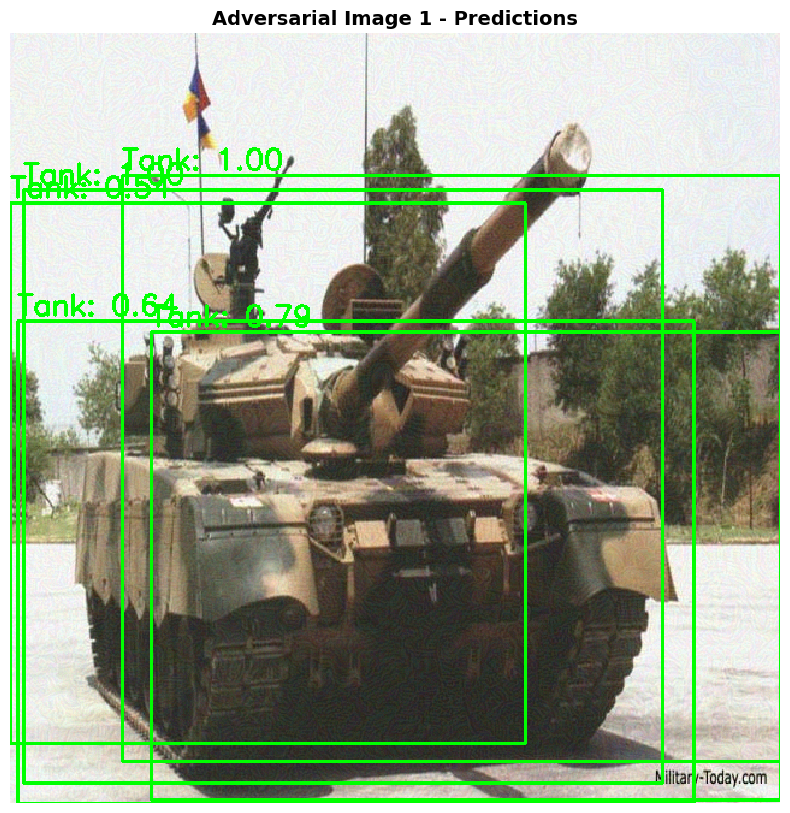

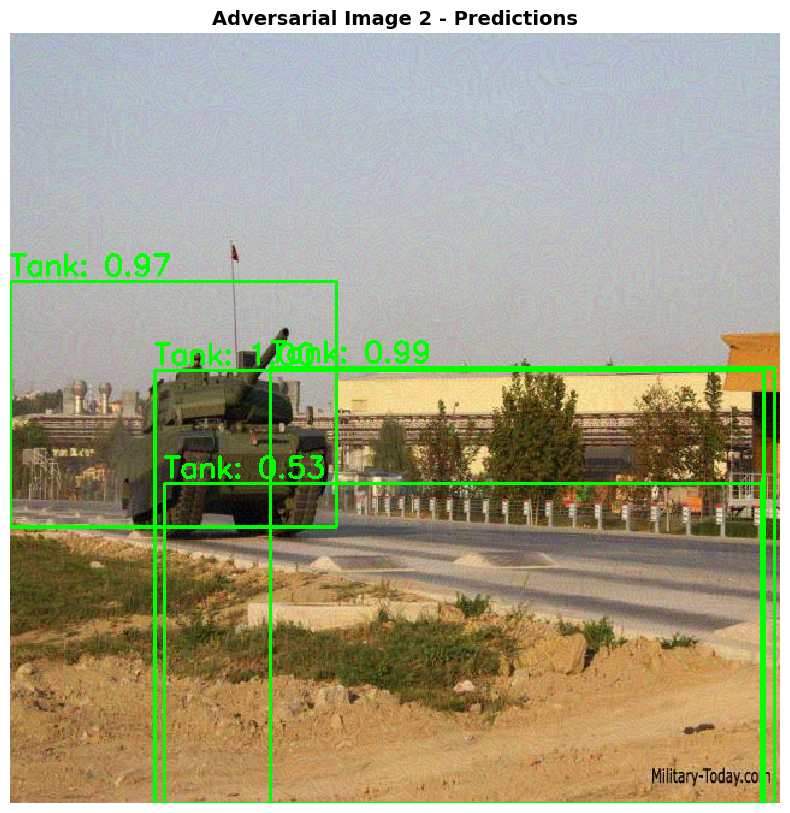

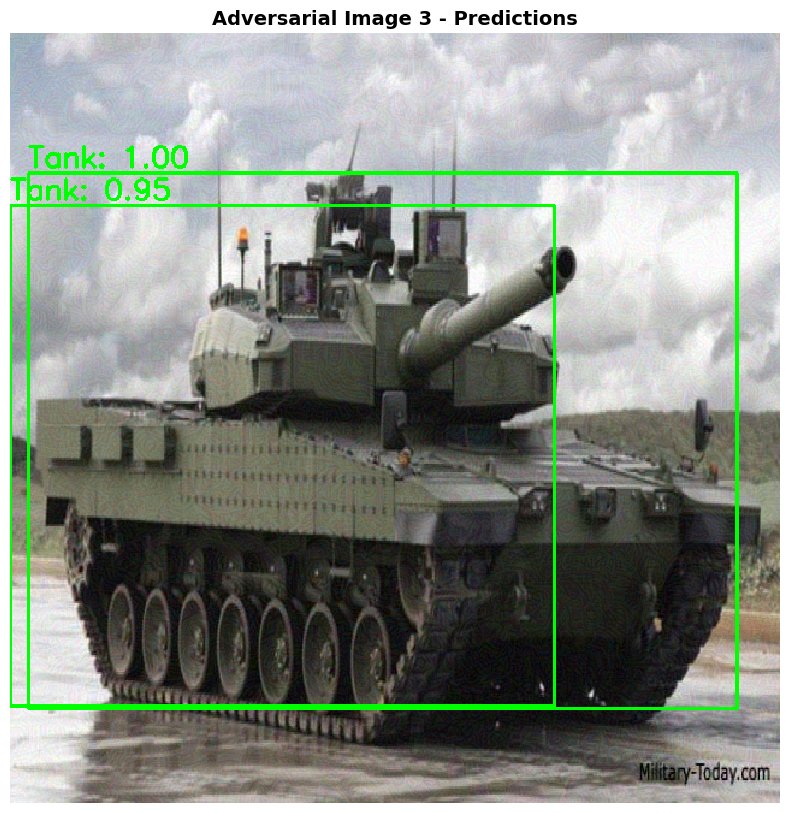

In [16]:
# 적대적 예제 탐지 결과 시각화
print("\nVisualizing adversarial image detections...")

for i in range(min(3, len(dets_adversarial))):
    preds_adv = extract_predictions(dets_adversarial[i], conf_thresh=0.5)
    img_display = adversarial_images[i].transpose(1, 2, 0).copy()
    plot_image_with_boxes(
        img=img_display,
        boxes=preds_adv[1],
        pred_cls=preds_adv[0],
        pred_scores=preds_adv[2],
        title=f"Adversarial Image {i+1} - Predictions"
    )

## 12. 공격 성공률 분석

In [17]:
# 공격 효과 메트릭 계산
def calculate_attack_success(original_dets, adversarial_dets, conf_thresh=0.5):
    total_original = 0
    total_adversarial = 0
    
    for orig, adv in zip(original_dets, adversarial_dets):
        orig_boxes = [s for s in orig['scores'] if s > conf_thresh]
        adv_boxes = [s for s in adv['scores'] if s > conf_thresh]
        
        total_original += len(orig_boxes)
        total_adversarial += len(adv_boxes)
    
    reduction_rate = (total_original - total_adversarial) / total_original * 100 if total_original > 0 else 0
    
    return {
        'total_original': total_original,
        'total_adversarial': total_adversarial,
        'reduction_rate': reduction_rate
    }

metrics = calculate_attack_success(dets_original, dets_adversarial)

print("\n" + "="*60)
print("PGD ATTACK RESULTS")
print("="*60)
print(f"Original detections: {metrics['total_original']}")
print(f"Adversarial detections: {metrics['total_adversarial']}")
print(f"Detection reduction rate: {metrics['reduction_rate']:.1f}%")
print("="*60)


PGD ATTACK RESULTS
Original detections: 0
Adversarial detections: 41
Detection reduction rate: 0.0%


## 13. 원본 vs 적대적 예제 비교

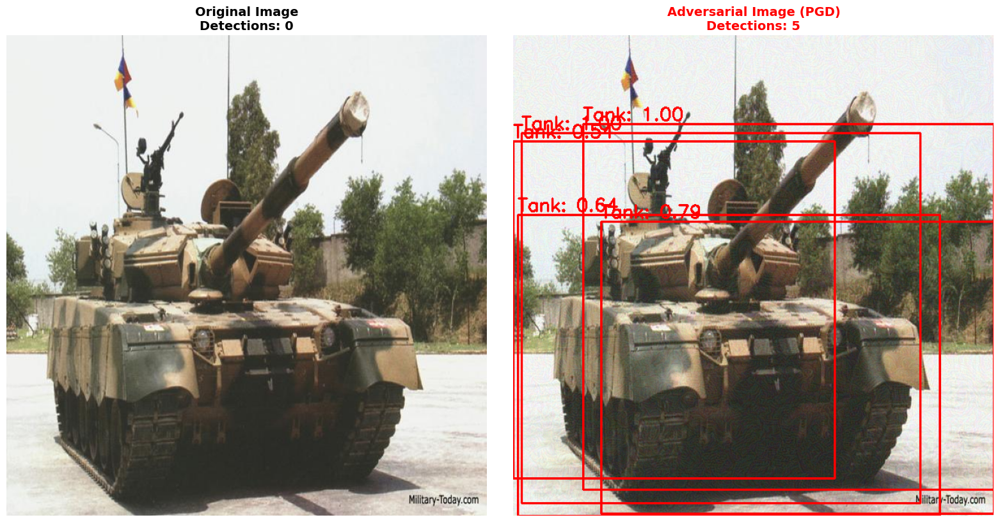

In [18]:
# 시각적 비교 (원본 vs 적대적)
fig, axes = plt.subplots(1, 2, figsize=(16, 8))

# 원본
img_idx = 0
img_orig = tank_images[img_idx].transpose(1, 2, 0).copy()
preds_orig = extract_predictions(dets_original[img_idx], conf_thresh=0.5)

for box, label, score in zip(preds_orig[1], preds_orig[0], preds_orig[2]):
    cv2.rectangle(img_orig, (int(box[0][0]), int(box[0][1])), (int(box[1][0]), int(box[1][1])),
                  color=(0, 255, 0), thickness=2)
    cv2.putText(img_orig, f"{label}: {score:.2f}", (int(box[0][0]), int(box[0][1]) - 5),
                cv2.FONT_HERSHEY_SIMPLEX, 0.8, (0, 255, 0), thickness=2)

axes[0].imshow(img_orig.astype(np.uint8))
axes[0].set_title(f"Original Image\nDetections: {len(preds_orig[0])}", fontsize=14, weight='bold')
axes[0].axis('off')

# 적대적
img_adv = adversarial_images[img_idx].transpose(1, 2, 0).copy()
preds_adv = extract_predictions(dets_adversarial[img_idx], conf_thresh=0.5)

for box, label, score in zip(preds_adv[1], preds_adv[0], preds_adv[2]):
    cv2.rectangle(img_adv, (int(box[0][0]), int(box[0][1])), (int(box[1][0]), int(box[1][1])),
                  color=(255, 0, 0), thickness=2)
    cv2.putText(img_adv, f"{label}: {score:.2f}", (int(box[0][0]), int(box[0][1]) - 5),
                cv2.FONT_HERSHEY_SIMPLEX, 0.8, (255, 0, 0), thickness=2)

axes[1].imshow(img_adv.astype(np.uint8))
axes[1].set_title(f"Adversarial Image (PGD)\nDetections: {len(preds_adv[0])}", fontsize=14, weight='bold', color='red')
axes[1].axis('off')

plt.tight_layout()
plt.show()

## 14. 적대적 예제 저장

In [19]:
# 생성된 적대적 예제 저장
# Use relative path from notebook directory
output_dir = NOTEBOOK_DIR / "adversarial_pgd"
output_dir.mkdir(parents=True, exist_ok=True)

print(f"Output directory: {output_dir.resolve()}")

# 적대적 예제 저장 (numpy)
adv_path = output_dir / "tank_adversarial_pgd.npy"
np.save(adv_path, adversarial_images)
print(f"Adversarial examples saved to: {adv_path.resolve()}")

# 샘플 이미지 저장 (PNG)
for i in range(min(3, len(adversarial_images))):
    img_path = output_dir / f"tank_adversarial_{i+1}.png"
    img = adversarial_images[i].transpose(1, 2, 0).astype(np.uint8)
    Image.fromarray(img).save(img_path)
    print(f"Sample {i+1} saved to: {img_path.resolve()}")

# 섭동 저장
perturbations = adversarial_images - tank_images
pert_path = output_dir / "tank_perturbations_pgd.npy"
np.save(pert_path, perturbations)
print(f"Perturbations saved to: {pert_path.resolve()}")

Output directory: /home/jaehyun/art_train/yolo_train/art_training/attacks/adversarial_pgd
Adversarial examples saved to: /home/jaehyun/art_train/yolo_train/art_training/attacks/adversarial_pgd/tank_adversarial_pgd.npy
Sample 1 saved to: /home/jaehyun/art_train/yolo_train/art_training/attacks/adversarial_pgd/tank_adversarial_1.png
Sample 2 saved to: /home/jaehyun/art_train/yolo_train/art_training/attacks/adversarial_pgd/tank_adversarial_2.png
Sample 3 saved to: /home/jaehyun/art_train/yolo_train/art_training/attacks/adversarial_pgd/tank_adversarial_3.png
Perturbations saved to: /home/jaehyun/art_train/yolo_train/art_training/attacks/adversarial_pgd/tank_perturbations_pgd.npy


In [20]:
# Tank 클래스만 필터링하는 함수
def extract_tank_predictions(predictions, conf_thresh=0.5):
    """Tank 클래스(class_id=80)만 필터링"""
    if not isinstance(predictions, dict):
        return [], [], []
    
    tank_class_id = 80  # Tank class ID
    
    predictions_boxes = []
    predictions_scores = []
    predictions_class = []
    
    for i in range(len(predictions["boxes"])):
        score = predictions["scores"][i]
        label = int(predictions["labels"][i])
        
        # Tank 클래스이고 신뢰도 임계값 이상인 경우만 추가
        if label == tank_class_id and score > conf_thresh:
            box = predictions["boxes"][i]
            predictions_boxes.append([(box[0], box[1]), (box[2], box[3])])
            predictions_scores.append(score)
            predictions_class.append(CLASS_NAMES[tank_class_id])
    
    return predictions_class, predictions_boxes, predictions_scores


# 원본 vs 적대적 예제에서 Tank 탐지 비교
print("="*70)
print("Tank Class Detection Comparison (Original vs Adversarial)")
print("="*70)

total_tank_original = 0
total_tank_adversarial = 0

for i in range(len(dets_original)):
    # 원본 이미지의 Tank 탐지
    tank_orig = extract_tank_predictions(dets_original[i], conf_thresh=0.5)
    num_tank_orig = len(tank_orig[0])
    
    # 적대적 이미지의 Tank 탐지
    tank_adv = extract_tank_predictions(dets_adversarial[i], conf_thresh=0.5)
    num_tank_adv = len(tank_adv[0])
    
    total_tank_original += num_tank_orig
    total_tank_adversarial += num_tank_adv
    
    if num_tank_orig > 0 or num_tank_adv > 0:  # Tank가 하나라도 있는 경우만 출력
        print(f"\nImage {i+1}:")
        print(f"  Original - Tank detections: {num_tank_orig}")
        if num_tank_orig > 0:
            for j, score in enumerate(tank_orig[2]):
                print(f"    Tank {j+1}: confidence {score:.4f}")
        
        print(f"  Adversarial - Tank detections: {num_tank_adv}")
        if num_tank_adv > 0:
            for j, score in enumerate(tank_adv[2]):
                print(f"    Tank {j+1}: confidence {score:.4f}")
        
        reduction = num_tank_orig - num_tank_adv
        if reduction > 0:
            print(f"  ✓ Attack Success: {reduction} tank(s) evaded")
        elif reduction < 0:
            print(f"  ✗ Attack Failed: {-reduction} more tank(s) detected")
        else:
            print(f"  - No change in tank detection")

print("\n" + "="*70)
print("Summary - Tank Detection")
print("="*70)
print(f"Total Tank detections (Original): {total_tank_original}")
print(f"Total Tank detections (Adversarial): {total_tank_adversarial}")
reduction_rate = (total_tank_original - total_tank_adversarial) / total_tank_original * 100 if total_tank_original > 0 else 0
print(f"Tank detection reduction rate: {reduction_rate:.1f}%")

if reduction_rate > 0:
    print(f"\n✓ PGD attack successfully reduced Tank detection by {reduction_rate:.1f}%")
elif reduction_rate < 0:
    print(f"\n✗ PGD attack failed - Tank detection increased by {-reduction_rate:.1f}%")
else:
    print(f"\n- PGD attack had no effect on Tank detection")
print("="*70)

Tank Class Detection Comparison (Original vs Adversarial)

Summary - Tank Detection
Total Tank detections (Original): 0
Total Tank detections (Adversarial): 0
Tank detection reduction rate: 0.0%

- PGD attack had no effect on Tank detection



Visualizing Tank-only detections comparison...



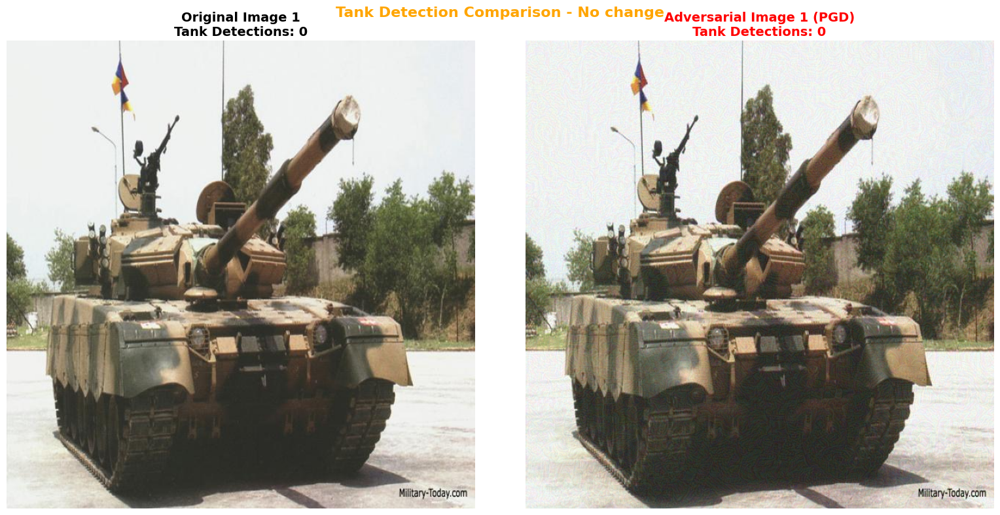

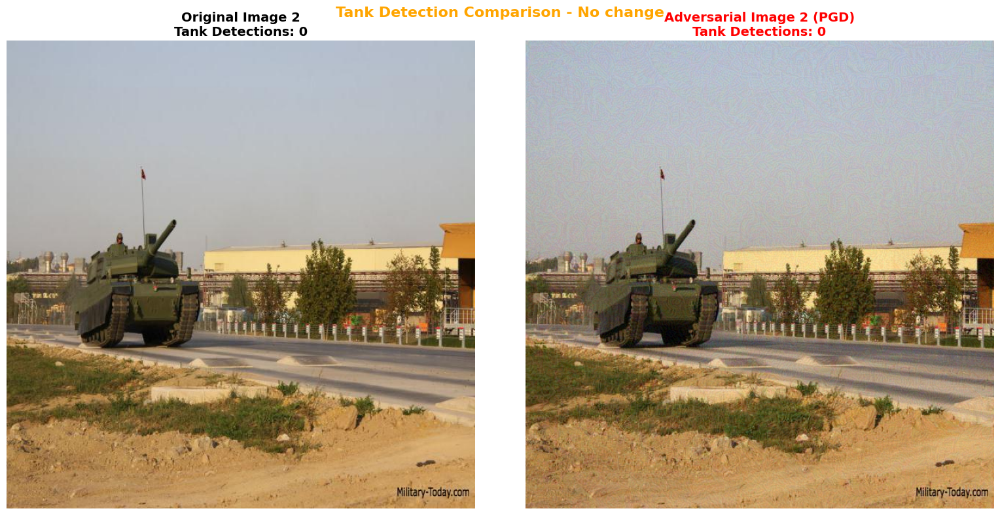

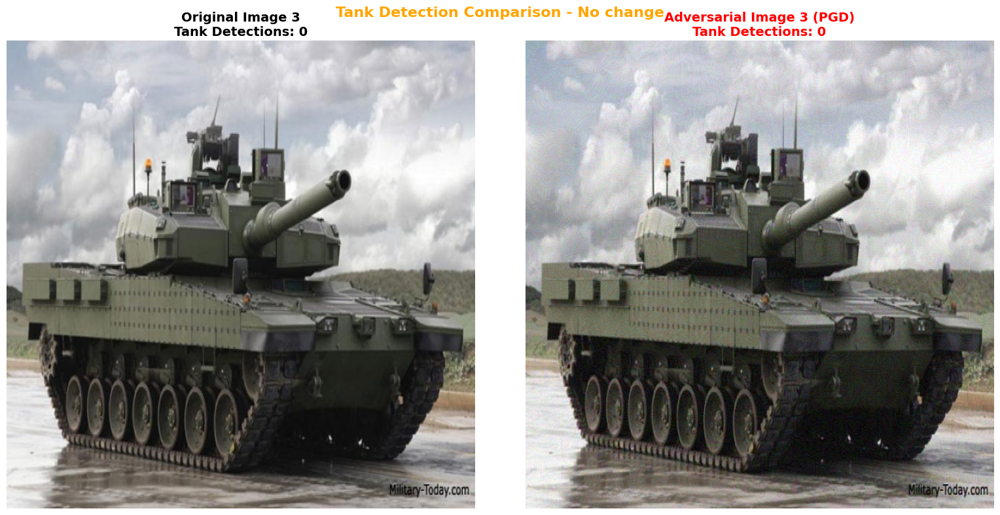

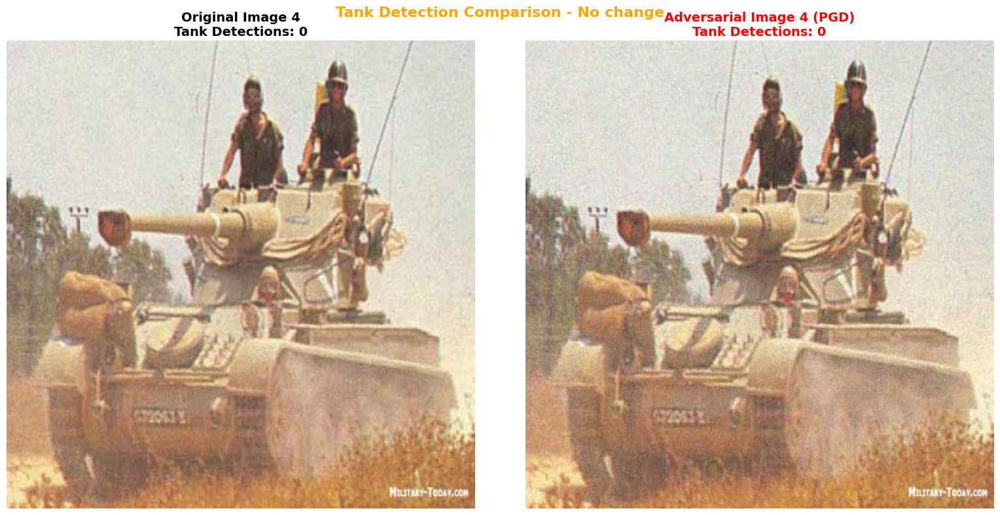

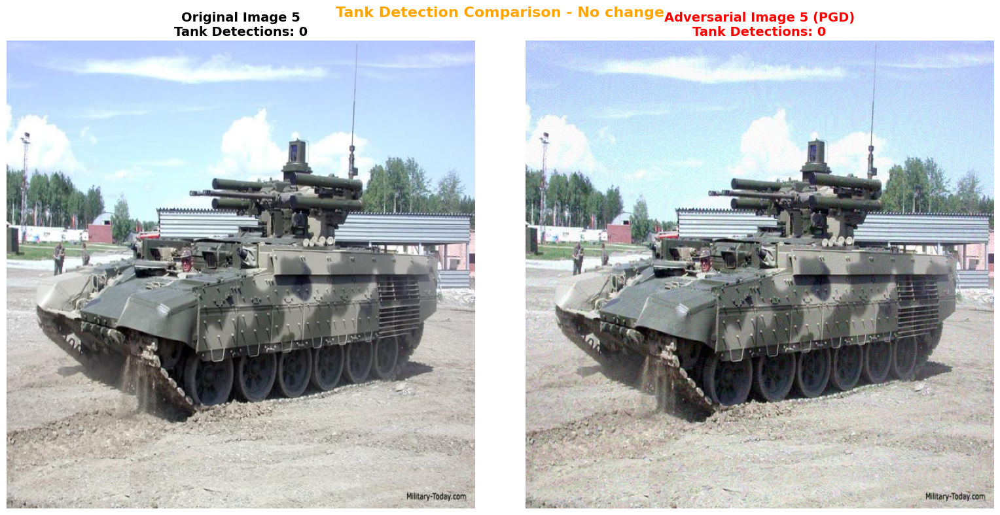

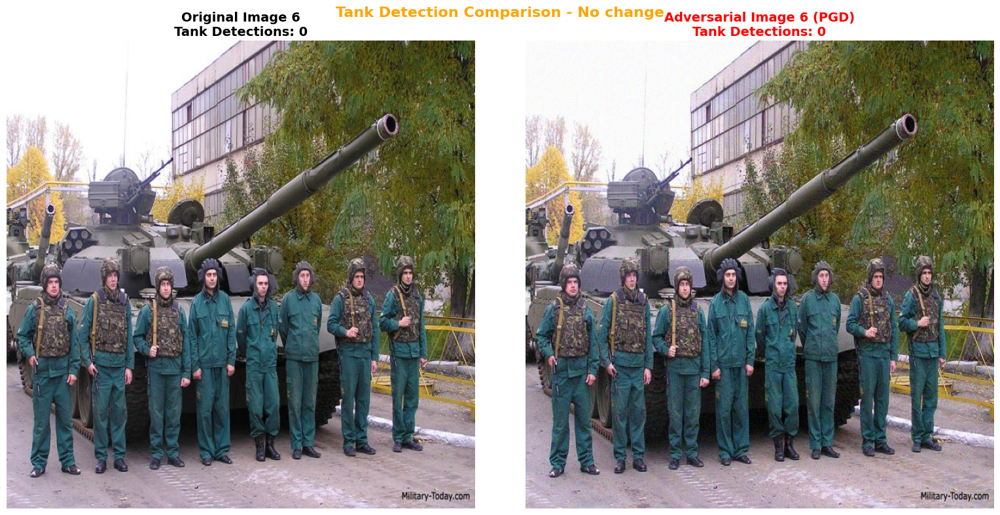

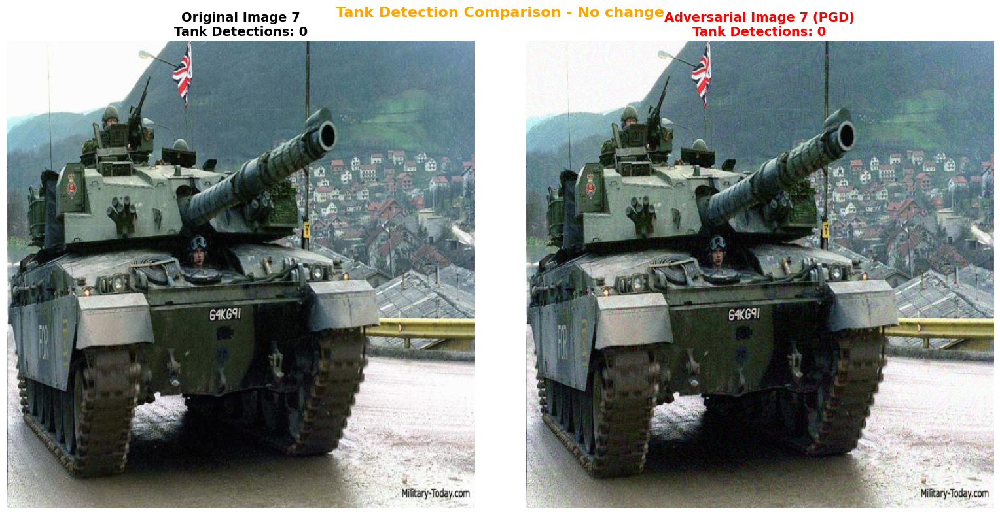

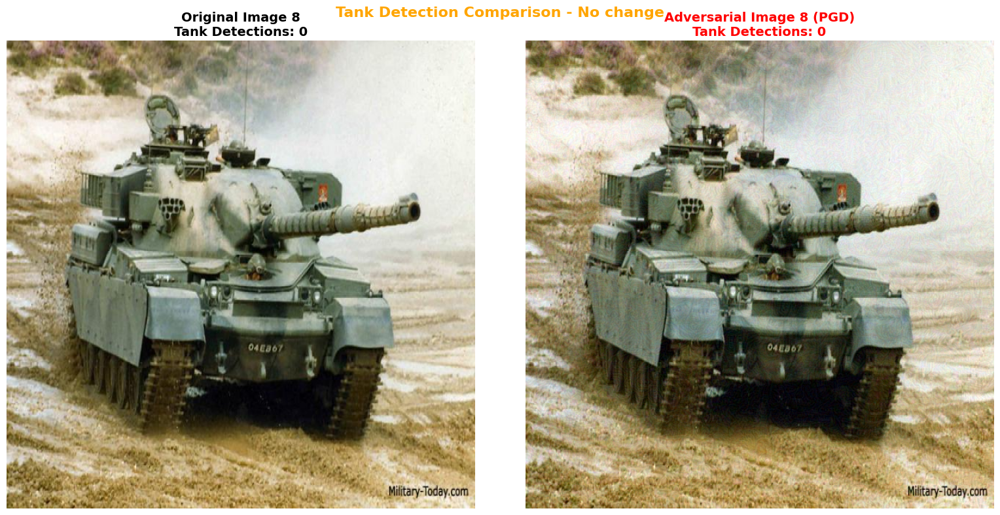

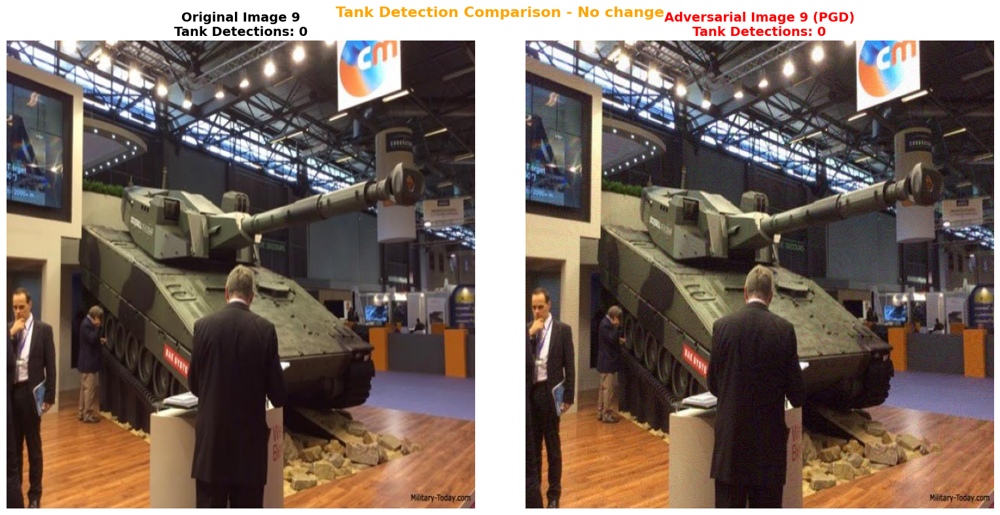

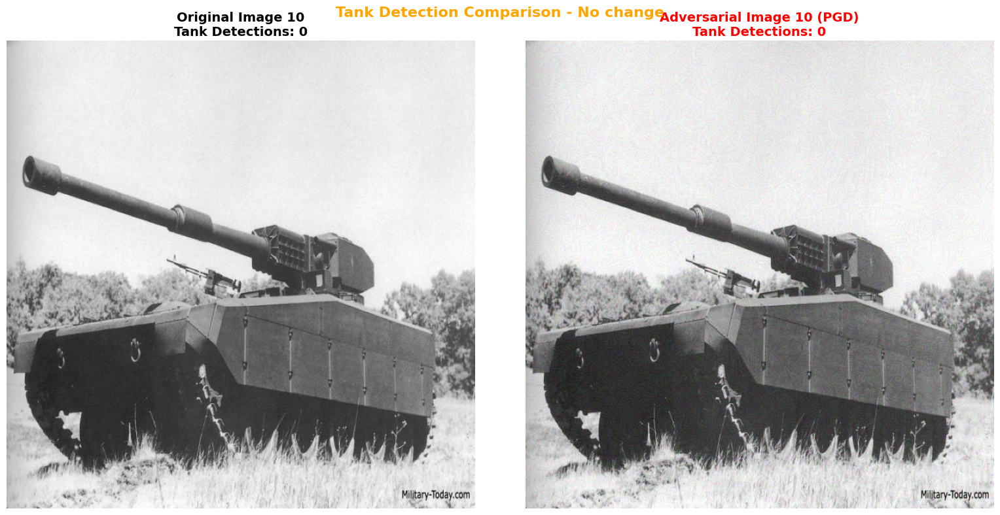

In [ ]:
# Tank 클래스만 시각화 비교 (원본 vs 적대적)
print("\nVisualizing Tank-only detections comparison...\n")

for idx in range(0, len(tank_images)):
    fig, axes = plt.subplots(1, 2, figsize=(16, 8))
    
    # 원본 이미지 - Tank만
    img_orig = tank_images[idx].transpose(1, 2, 0).copy()
    tank_orig = extract_tank_predictions(dets_original[idx], conf_thresh=0.5)
    
    for box, label, score in zip(tank_orig[1], tank_orig[0], tank_orig[2]):
        cv2.rectangle(img_orig, 
                     (int(box[0][0]), int(box[0][1])), 
                     (int(box[1][0]), int(box[1][1])),
                     color=(0, 255, 0), thickness=3)
        cv2.putText(img_orig, f"{label}: {score:.2f}", 
                   (int(box[0][0]), int(box[0][1]) - 10),
                   cv2.FONT_HERSHEY_SIMPLEX, 0.9, (0, 255, 0), thickness=2)
    
    axes[0].imshow(img_orig.astype(np.uint8))
    axes[0].set_title(f"Original Image {idx+1}\nTank Detections: {len(tank_orig[0])}", 
                     fontsize=14, weight='bold')
    axes[0].axis('off')
    
    # 적대적 이미지 - Tank만
    img_adv = adversarial_images[idx].transpose(1, 2, 0).copy()
    tank_adv = extract_tank_predictions(dets_adversarial[idx], conf_thresh=0.5)
    
    for box, label, score in zip(tank_adv[1], tank_adv[0], tank_adv[2]):
        cv2.rectangle(img_adv, 
                     (int(box[0][0]), int(box[0][1])), 
                     (int(box[1][0]), int(box[1][1])),
                     color=(255, 0, 0), thickness=3)
        cv2.putText(img_adv, f"{label}: {score:.2f}", 
                   (int(box[0][0]), int(box[0][1]) - 10),
                   cv2.FONT_HERSHEY_SIMPLEX, 0.9, (255, 0, 0), thickness=2)
    
    axes[1].imshow(img_adv.astype(np.uint8))
    axes[1].set_title(f"Adversarial Image {idx+1} (PGD)\nTank Detections: {len(tank_adv[0])}", 
                     fontsize=14, weight='bold', color='red')
    axes[1].axis('off')
    
    # 공격 성공 여부 표시
    reduction = len(tank_orig[0]) - len(tank_adv[0])
    if reduction > 0:
        status = f"Attack Success: {reduction} tank(s) evaded"
        color = 'green'
    elif reduction < 0:
        status = f"Attack Failed: {-reduction} more tank(s) detected"
        color = 'red'
    else:
        status = "No change"
        color = 'orange'
    
    fig.suptitle(f"Tank Detection Comparison - {status}", 
                fontsize=16, weight='bold', color=color, y=0.98)
    
    plt.tight_layout()
    plt.show()

## 결론

이 실습에서는:
1. YOLOv8 모델을 ART의 PyTorchYolo estimator로 래핑
2. 커스텀 Tank 데이터셋 로드
3. PGD (Projected Gradient Descent)를 사용한 적대적 예제 생성
4. **Tank 클래스에 대한 탐지 성능 변화를 집중 분석**

**핵심 결과:**
- PGD는 전체 이미지에 미세한 섭동을 추가하여 Tank 탐지를 회피
- 육안으로 구별하기 어려운 작은 변화로 Tank 탐지 성능을 크게 저하시킬 수 있음
- Tank 클래스만 필터링했을 때의 공격 효과를 명확히 확인

**PGD vs Patch 비교:**
- **PGD**: 전체 이미지 섭동, 디지털 공격, 물리 구현 어려움
- **Patch**: 국소적 패치, 물리적 구현 가능, 실제 위협 시나리오

**방어 방법:**
- Adversarial Training: 적대적 예제를 학습 데이터에 포함
- Input Preprocessing: 이미지 전처리로 섭동 제거 (JPEG compression, Gaussian blur 등)
- Detection: 적대적 예제 탐지 및 거부
- Ensemble Methods: 여러 모델의 앙상블로 강건성 향상